In [1]:
import numpy as np
import matplotlib.pyplot as plt
import librosa
from IPython.display import Audio
from sklearn.decomposition import FastICA
from sklearn.preprocessing import StandardScaler
from scipy.signal import butter, filtfilt

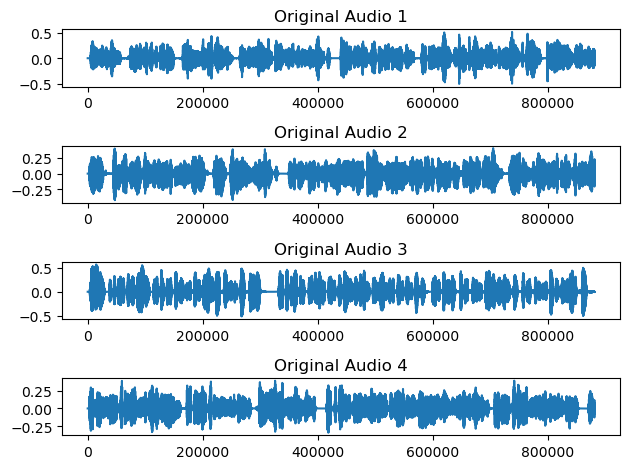

In [2]:
original_paths = [
    "C:/Users/keerthivasan.s/Downloads/Washinton - American Woman.mp3",
    "C:/Users/keerthivasan.s/Downloads/New York - American Man.mp3",
    "C:/Users/keerthivasan.s/Downloads/Miami - Australian Woman.mp3",
    "C:/Users/keerthivasan.s/Downloads/Chicago - British Woman.mp3"
]
original_audios = [(librosa.load(path, sr=44100)[0][:44100*20]) for path in original_paths]
# print(original_audios)

for i, audio in enumerate(original_audios):
    plt.subplot(4, 1, i + 1)
    plt.plot(audio)
    plt.title(f'Original Audio {i+1}')
plt.tight_layout()
plt.show()

for audio in original_audios:
    display(Audio(audio, rate=44100))

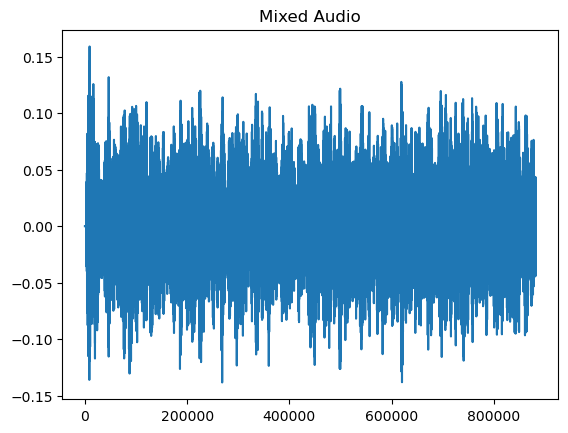

In [3]:
mixed_path = "C:/Users/keerthivasan.s/Downloads/Audio mix.mp3"
mixed_audio, _ = librosa.load(mixed_path, sr=44100)
mixed_audio = mixed_audio[:44100 * 20]

plt.plot(mixed_audio)
plt.title('Mixed Audio')
plt.show()

display(Audio(mixed_audio, rate=44100))

In [9]:
b, a = butter(N=2, Wn=1/(44100/2), btype='highpass')

# Apply the high-pass filter to the mixed audio
filtered_audio = filtfilt(b, a, mixed_audio)

# Stack the mixed audio 4 times for ICA
X = np.vstack([filtered_audio for _ in range(4)]).T

# Scale the data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
print(X_scaled)

[[-0.00276795 -0.00276795 -0.00276795 -0.00276795]
 [-0.00279122 -0.00279122 -0.00279122 -0.00279122]
 [-0.00283281 -0.00283281 -0.00283281 -0.00283281]
 ...
 [-0.5283253  -0.5283253  -0.5283253  -0.5283253 ]
 [-0.50309849 -0.50309849 -0.50309849 -0.50309849]
 [-0.49097204 -0.49097204 -0.49097204 -0.49097204]]


C:\Users\keerthivasan.s\AppData\Local\anaconda3\Lib\site-packages\sklearn\decomposition\_fastica.py:128: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(
C:\Users\keerthivasan.s\AppData\Local\anaconda3\Lib\site-packages\numpy\core\_methods.py:239: RuntimeWarning: overflow encountered in multiply
  x = um.multiply(x, x, out=x)


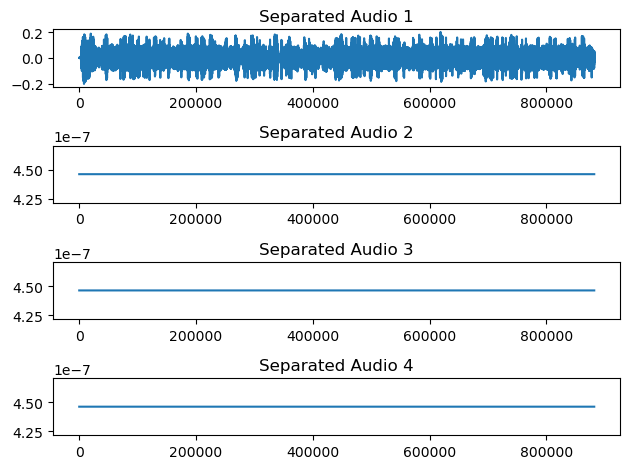

In [10]:
ica = FastICA(n_components=4, tol=0.01)
separated_audios = ica.fit_transform(X_scaled)

# Rescale back to the original range
separated_audios = scaler.inverse_transform(separated_audios).T

for i, audio in enumerate(separated_audios):
    plt.subplot(4, 1, i + 1)
    plt.plot(audio)
    plt.title(f'Separated Audio {i+1}')
plt.tight_layout()
plt.show()

for audio in separated_audios:
    display(Audio(audio, rate=44100))